In [99]:
import numpy as np
import matplotlib.pyplot as plt

from tensorflow import keras
from keras.datasets.mnist import load_data

## Step 1 Load the dataset

In [100]:
#Storing MNIST Dataset in data
data=load_data()

In [101]:
#It prints the shape of data
np.shape(data)

(2, 2)

The data is structured as two rows and two columns

1.The first row is the training data and second row is the testing data.<br> 
2.The first column consists of images and the second column is the label for images

In [102]:
#Unpacking the data in training and testing with their corresponding labels
(train_images,train_labels),(test_images,test_labels)=data

In [103]:
#Print the first training image which is stored as numpy
train_images [0]

array([[  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,
          0,   0],
       [  0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   0,   3,
         18,  18,  18, 126, 136, 175,  26, 166, 255, 247, 127,   0,   0,
          0,   0],
       [  

In [104]:
#Print the training Label of first image which is stored as numpy array
train_labels[0]

5

In [105]:
#Print all the distinct labels in training dataset
set(train_labels)

{0, 1, 2, 3, 4, 5, 6, 7, 8, 9}

In [106]:
print('Max pixel value:',train_images[0].max())
print('Min pixel value:',train_images[0].min())
print()
print('Shape of training data:',train_images.shape)
print('Shape of each training example:', train_images[0].shape)
print()
print('Shape of testing data:',test_images.shape)
print('Shape of each testing example:', test_images[0].shape)

Max pixel value: 255
Min pixel value: 0

Shape of training data: (60000, 28, 28)
Shape of each training example: (28, 28)

Shape of testing data: (10000, 28, 28)
Shape of each testing example: (28, 28)


In [107]:
print('Label : ',train_labels[0])#printing the first label
print(train_images[0, 5:23, 5:23])

Label :  5
[[  0   0   0   0   0   0   0   3  18  18  18 126 136 175  26 166 255 247]
 [  0   0   0  30  36  94 154 170 253 253 253 253 253 225 172 253 242 195]
 [  0   0  49 238 253 253 253 253 253 253 253 253 251  93  82  82  56  39]
 [  0   0  18 219 253 253 253 253 253 198 182 247 241   0   0   0   0   0]
 [  0   0   0  80 156 107 253 253 205  11   0  43 154   0   0   0   0   0]
 [  0   0   0   0  14   1 154 253  90   0   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0 139 253 190   2   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0  11 190 253  70   0   0   0   0   0   0   0   0]
 [  0   0   0   0   0   0   0  35 241 225 160 108   1   0   0   0   0   0]
 [  0   0   0   0   0   0   0   0  81 240 253 253 119  25   0   0   0   0]
 [  0   0   0   0   0   0   0   0   0  45 186 253 253 150  27   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0  16  93 252 253 187   0   0   0]
 [  0   0   0   0   0   0   0   0   0   0   0   0 249 253 249  64   0   0]
 [  0   0   0 

## Step 2 Visualising the dataset

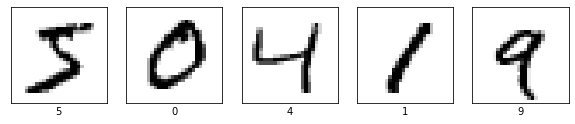

In [108]:
#It sets the width and height of image
plt.figure(figsize=(10,10)) 
for i in range(5):
    plt.subplot(1,5,i+1)
    plt.xticks([])
    plt.yticks([])
    plt.imshow(train_images[i], cmap=plt.cm.binary)
    plt.xlabel(train_labels[i])

## Step 3 Data Preprocessing

Scaling the data(Converting all the pixel values which are in the range(0-255) to (0-1)<br>
This helps to reduce the complexity and trains faster.

In [109]:
#Before scaling the pixels of first image are as follows
np.unique(train_images[0])

array([  0,   1,   2,   3,   9,  11,  14,  16,  18,  23,  24,  25,  26,
        27,  30,  35,  36,  39,  43,  45,  46,  49,  55,  56,  64,  66,
        70,  78,  80,  81,  82,  90,  93,  94, 107, 108, 114, 119, 126,
       127, 130, 132, 133, 135, 136, 139, 148, 150, 154, 156, 160, 166,
       170, 171, 172, 175, 182, 183, 186, 187, 190, 195, 198, 201, 205,
       207, 212, 213, 219, 221, 225, 226, 229, 238, 240, 241, 242, 244,
       247, 249, 250, 251, 252, 253, 255], dtype=uint8)

In [110]:
train_images=train_images / 255.0
test_images=test_images / 255.0

In [111]:
#After scaling the pixels of first image are as follows
np.unique(train_images[0])

array([0.        , 0.00392157, 0.00784314, 0.01176471, 0.03529412,
       0.04313725, 0.05490196, 0.0627451 , 0.07058824, 0.09019608,
       0.09411765, 0.09803922, 0.10196078, 0.10588235, 0.11764706,
       0.1372549 , 0.14117647, 0.15294118, 0.16862745, 0.17647059,
       0.18039216, 0.19215686, 0.21568627, 0.21960784, 0.25098039,
       0.25882353, 0.2745098 , 0.30588235, 0.31372549, 0.31764706,
       0.32156863, 0.35294118, 0.36470588, 0.36862745, 0.41960784,
       0.42352941, 0.44705882, 0.46666667, 0.49411765, 0.49803922,
       0.50980392, 0.51764706, 0.52156863, 0.52941176, 0.53333333,
       0.54509804, 0.58039216, 0.58823529, 0.60392157, 0.61176471,
       0.62745098, 0.65098039, 0.66666667, 0.67058824, 0.6745098 ,
       0.68627451, 0.71372549, 0.71764706, 0.72941176, 0.73333333,
       0.74509804, 0.76470588, 0.77647059, 0.78823529, 0.80392157,
       0.81176471, 0.83137255, 0.83529412, 0.85882353, 0.86666667,
       0.88235294, 0.88627451, 0.89803922, 0.93333333, 0.94117

# Step 4 Build the Model


## Steps to build the model:


1.Setting up the input layer,hidden layer and output layer<br>
2.Compile the model

In [112]:
#Considering the layer as a hole
#SOFTMAX:-ACTIVATION FUNCTION/LAYER WHICH INTERPRETS OUTPUT AS PROBABILITIES
model=keras.Sequential([
    keras.layers.Flatten(input_shape=(28,28)),
    keras.layers.Dense(128,activation='sigmoid'),
    keras.layers.Dense(10, activation='softmax')
])

### Examine the stucture of weights of the hidden layer

In [113]:
#To get the hidden layer from the model
hidden_layer=model.layers[1]
weights=hidden_layer.get_weights()
print('Shape of weights:',np.shape(weights[0]))
print('Shape of biases:',np.shape(weights[1]))


Shape of weights: (784, 128)
Shape of biases: (128,)


###  Examine the structure of weights of the output layer

In [114]:
#To get the output layer from the model
output_layer=model.layers[2]
weights=output_layer.get_weights()
print('Shape of weights : ',np.shape(weights[0]))
print('Shape of biases : ', np.shape(weights[1]))

Shape of weights :  (128, 10)
Shape of biases :  (10,)


   ### Compile the Model


    
   
   `optimizer`  sets the training method, here stochastic gradient descent.
    
   `learning_rate` is the learning rate.
   
   `loss` determines how the network error is calculated. In this example, we will be using sparse categorical cross-entropy.,
    
    
   
    
    

In [115]:
sgd=keras.optimizers.SGD(learning_rate=0.5, decay=1e-6, momentum=0.5)
model.compile(optimizer=sgd,
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# Step 4 Train the Model

In [116]:
history =model.fit(train_images,train_labels,epochs=10,batch_size=100,validation_split=0.1)

Epoch 1/10
540/540 [==============================] - 3s 4ms/step - loss: 0.4059 - accuracy: 0.8803 - val_loss: 0.2338 - val_accuracy: 0.9320
Epoch 2/10
540/540 [==============================] - 2s 4ms/step - loss: 0.2205 - accuracy: 0.9353 - val_loss: 0.1531 - val_accuracy: 0.9590
Epoch 3/10
540/540 [==============================] - 2s 3ms/step - loss: 0.1650 - accuracy: 0.9515 - val_loss: 0.1248 - val_accuracy: 0.9685
Epoch 4/10
540/540 [==============================] - 2s 3ms/step - loss: 0.1326 - accuracy: 0.9615 - val_loss: 0.1089 - val_accuracy: 0.9707
Epoch 5/10
540/540 [==============================] - 2s 3ms/step - loss: 0.1111 - accuracy: 0.9682 - val_loss: 0.0967 - val_accuracy: 0.9748
Epoch 6/10
540/540 [==============================] - 2s 3ms/step - loss: 0.0953 - accuracy: 0.9729 - val_loss: 0.0896 - val_accuracy: 0.9755
Epoch 7/10
540/540 [==============================] - 2s 3ms/step - loss: 0.0819 - accuracy: 0.9766 - val_loss: 0.0811 - val_accuracy: 0.9785
Epoch 

# Step 5 Visualize the model training
### To visualize validation loss against loss over the training data set per epoch

Text(0, 0.5, 'loss')

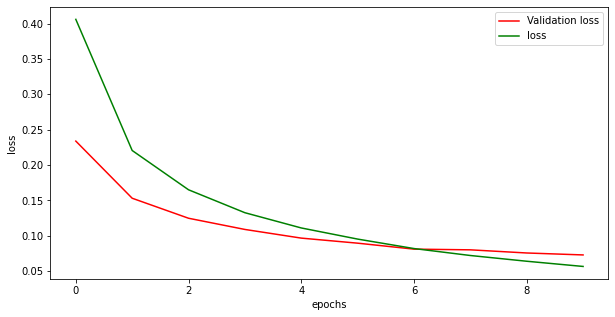

In [117]:
val_losses =history.history['val_loss']
losses = history.history['loss']
indices = range(len(losses))

plt.figure(figsize=(10, 5))
plt.plot(indices,val_losses, color='r')
plt.plot(indices, losses, color='g')
plt.legend(['Validation loss', 'loss'])
plt.xlabel('epochs')
plt.ylabel('loss')

# Step 6 Compute Accuracy and Make Predictions

###  Evaluate the model by computing the accuracy over testing data

In [118]:
test_loss, test_acc = model.evaluate(test_images, test_labels)
print('Test accuracy:', test_acc)

313/313 [==============================] - 1s 2ms/step - loss: 0.0770 - accuracy: 0.9773
Test accuracy: 0.9772999882698059


## Make Predictions
### With the model trained,we can use it to make predictions about the images in testing data.

In [119]:
predictions = model.predict(test_images)

313/313 [==============================] - 0s 866us/step


### Define a function to display image along the confidence intervals

Confidence levels show how confident is the model to predict ambiguous images.

In [120]:
def plot_confidence(images,labels,predictions):
    plt.figure(figsize=(15,30))
    plt.subplots_adjust(top =0.99,bottom=0.01,hspace=1.5, wspace=0.4)
    plot_index = 0
    for i in range(len(images)):
        plot_index += 1
        plt.subplot(len(images), 2,plot_index)
        plt.imshow(images[i],cmap=plt.cm.binary)
        correct_label =str(labels[i])
        predicted_label = str(np.argmax(predictions[i]))
        title = 'Correct label :' + str(labels [i]) +'\n'+'Predicted Label :'+str(np.argmax (predictions[i]))
            
        if predicted_label !=correct_label:
                plt.title(title, backgroundcolor='r',color='w')
        else:
                plt.title(title, backgroundcolor='g',color='w')
        plt.xticks([])
        plt.yticks([])
                               
        plot_index +=1
        plt.subplot(len(images),2,plot_index)
        plt.bar(range(10), predictions[i])
        plt.xticks(range(10))
        plt.ylim(0, 1)

### To visualize prediction of random samples

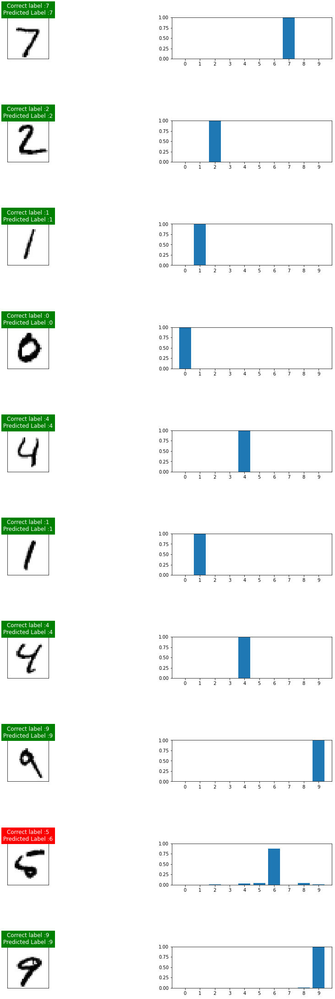

In [121]:
images = test_images[:10]
labels = test_labels[:10]
test_predictions = predictions[:10]
plot_confidence(images, labels,test_predictions)

### To visualize prediction of incorrect samples

Number of incorrectly classified images : 1
Number of incorrectly classified images : 2
Number of incorrectly classified images : 3
Number of incorrectly classified images : 4
Number of incorrectly classified images : 5
Number of incorrectly classified images : 6
Number of incorrectly classified images : 7
Number of incorrectly classified images : 8
Number of incorrectly classified images : 9
Number of incorrectly classified images : 10
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11


C:\Users\Admin\AppData\Local\Temp\ipykernel_18764\3987748562.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  plt.figure(figsize=(15,30))


Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of incorrectly classified images : 11
Number of 

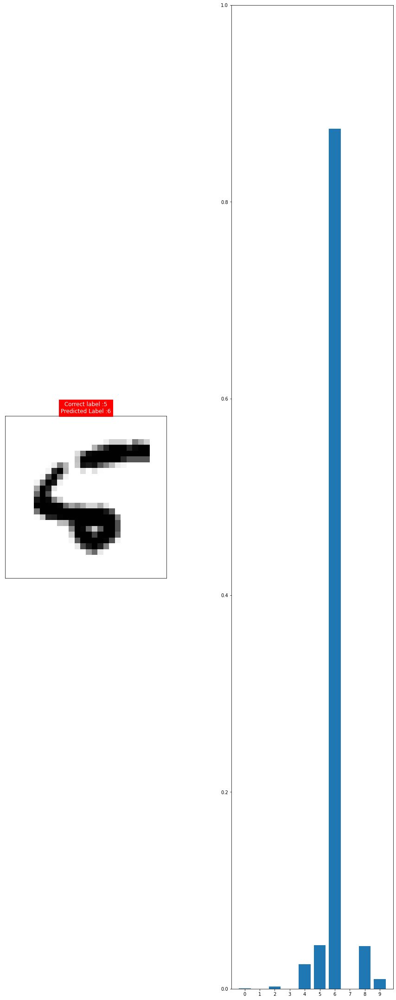

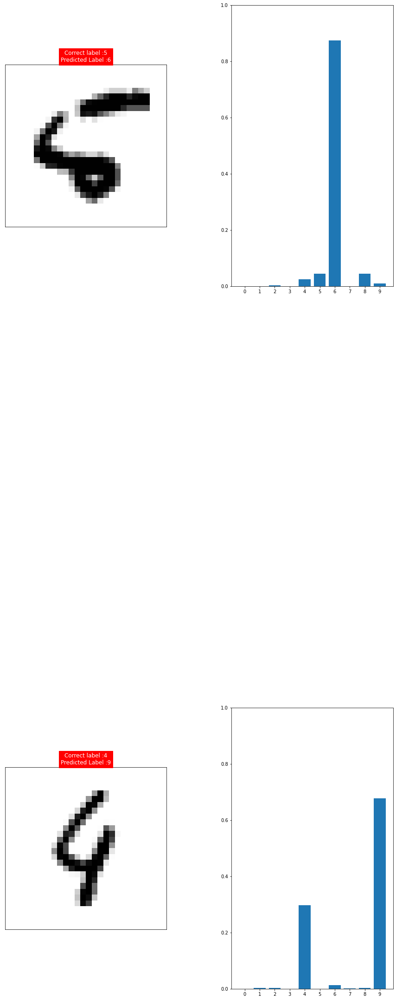

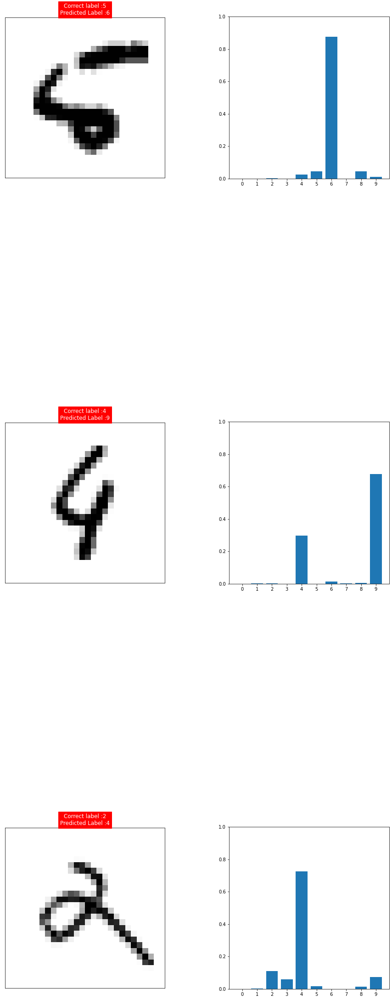

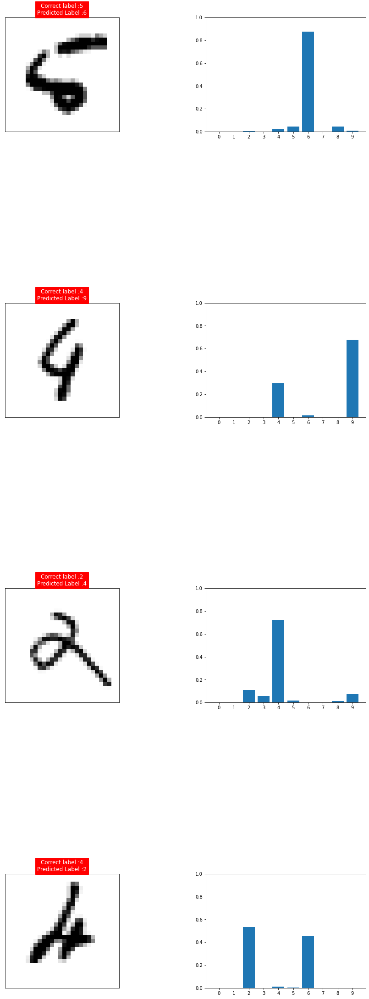

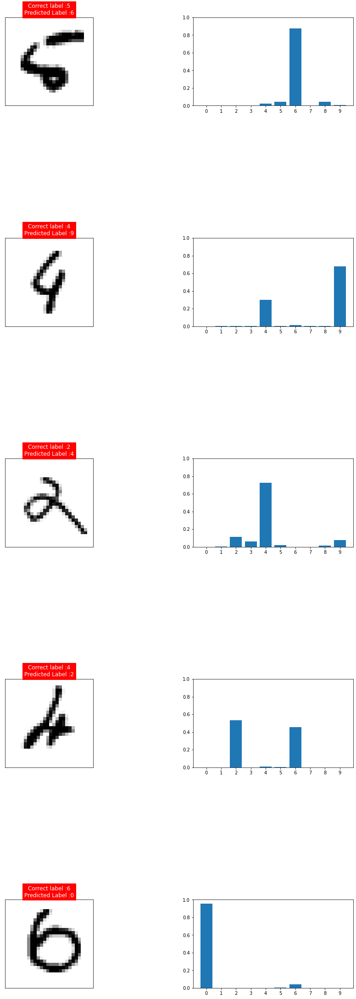

...

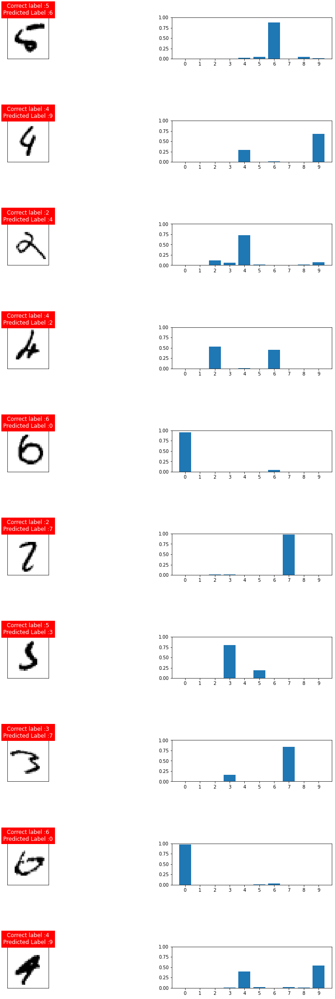

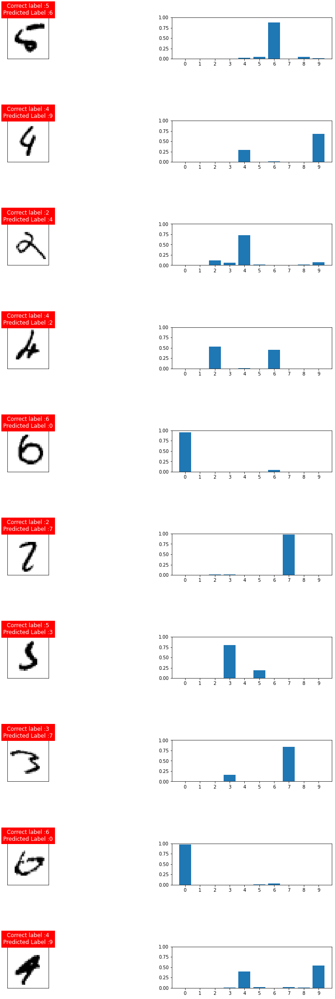

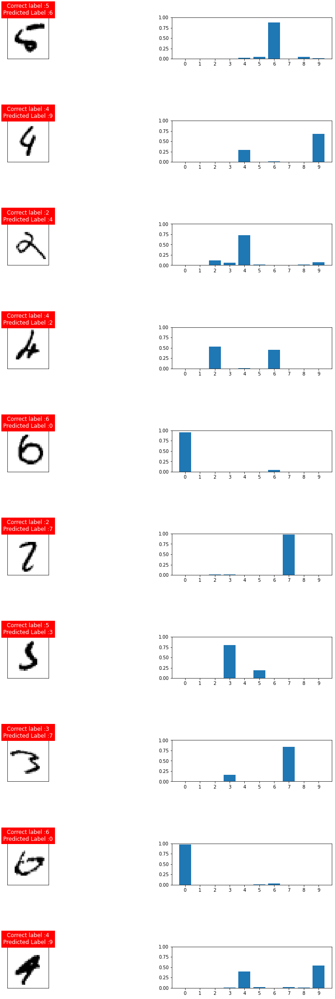

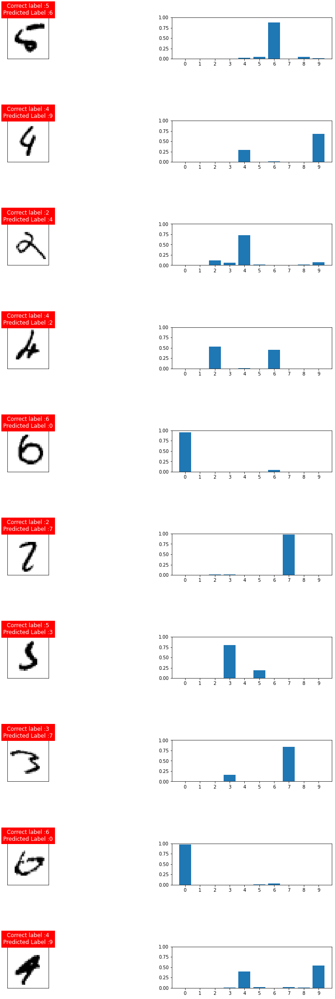

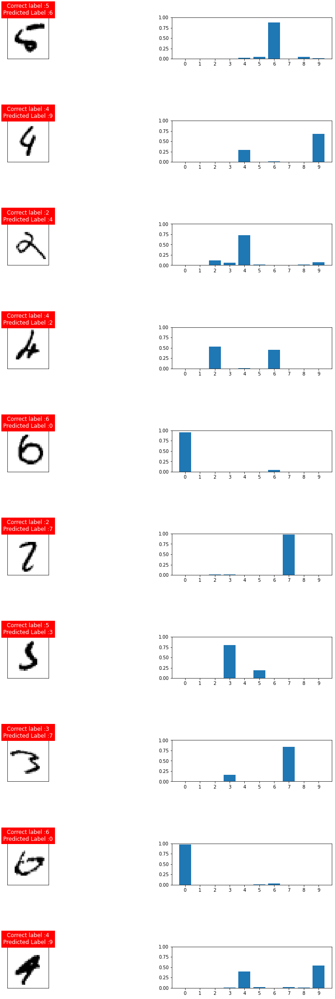

In [122]:
incorrect_indices =list()
for i in range(len(predictions)):
    predicted_label = np.argmax(predictions[i])
    if predicted_label != test_labels[i]:
        incorrect_indices.append(i)
        print('Number of incorrectly classified images :', len(incorrect_indices))
        
        incorrect_indices = incorrect_indices [:10]
        
        incorrect_images = [test_images[i]for i in  incorrect_indices]
        incorrect_labels = [test_labels[i]for i in incorrect_indices]
        incorrect_predictions = [predictions[i]for i in incorrect_indices]
        
        plot_confidence(incorrect_images, incorrect_labels, incorrect_predictions)